<a href="https://www.kaggle.com/code/muradpitafi/dcgan-on-cifar-dataset?scriptVersionId=203964553" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import numpy as np
import os



In [3]:
# Set random seed for reproducibility
seed = 42
torch.manual_seed(seed)

# Hyperparameters
batch_size = 128
image_size = 64  # Resized to 64x64
nc = 3  # Number of channels (RGB)
nz = 100  # Size of the latent vector
ngf = 64  # Size of feature maps in generator
ndf = 64  # Size of feature maps in discriminator
num_epochs = 25
lr = 0.0002
beta1 = 0.5  # Beta1 hyperparam for Adam optimizers
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



In [4]:
# Data preparation for CIFAR-10
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

dataset = datasets.CIFAR10(root="./data", download=True, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)



100%|██████████| 170498071/170498071 [00:03<00:00, 53561700.43it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


In [5]:
# Define the Generator
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)



In [6]:
# Define the Discriminator
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Initialize generator and discriminator
netG = Generator().to(device)
netD = Discriminator().to(device)



In [7]:
# Loss function
criterion = nn.BCELoss()

# Fixed noise for generator's progress visualization
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Optimizers
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Training loop
img_list = []
G_losses = []
D_losses = []

for epoch in range(num_epochs):
    for i, (data, _) in enumerate(dataloader):
        # Update Discriminator: maximize log(D(x)) + log(1 - D(G(z)))
        netD.zero_grad()
        real_data = data.to(device)
        b_size = real_data.size(0)
        label = torch.full((b_size,), 1, dtype=torch.float, device=device)  # Real label
        
        output = netD(real_data).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_data = netG(noise)
        label.fill_(0)  # Fake label
        
        output = netD(fake_data.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        optimizerD.step()

        # Update Generator: maximize log(D(G(z)))
        netG.zero_grad()
        label.fill_(1)  # Real label for generator
        output = netD(fake_data).view(-1)
        errG = criterion(output, label)
        errG.backward()
        optimizerG.step()

        # Save losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD_real.item() + errD_fake.item())
        
        # Save generator's output periodically
        if i % 100 == 0:
            print(f"Epoch [{epoch+1}/{num_epochs}] Step [{i}/{len(dataloader)}] "
                  f"Loss_D: {errD_real.item() + errD_fake.item():.4f} "
                  f"Loss_G: {errG.item():.4f}")
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))


Epoch [1/25] Step [0/391] Loss_D: 1.4084 Loss_G: 3.2507
Epoch [1/25] Step [100/391] Loss_D: 0.4739 Loss_G: 4.7129
Epoch [1/25] Step [200/391] Loss_D: 0.0719 Loss_G: 5.3073
Epoch [1/25] Step [300/391] Loss_D: 2.2936 Loss_G: 4.0552
Epoch [2/25] Step [0/391] Loss_D: 0.3435 Loss_G: 3.2412
Epoch [2/25] Step [100/391] Loss_D: 0.6071 Loss_G: 3.3235
Epoch [2/25] Step [200/391] Loss_D: 0.8808 Loss_G: 2.9855
Epoch [2/25] Step [300/391] Loss_D: 1.9687 Loss_G: 3.6455
Epoch [3/25] Step [0/391] Loss_D: 0.3462 Loss_G: 2.4051
Epoch [3/25] Step [100/391] Loss_D: 0.7903 Loss_G: 6.2982
Epoch [3/25] Step [200/391] Loss_D: 0.7583 Loss_G: 5.7054
Epoch [3/25] Step [300/391] Loss_D: 0.3046 Loss_G: 3.6894
Epoch [4/25] Step [0/391] Loss_D: 0.6254 Loss_G: 2.5175
Epoch [4/25] Step [100/391] Loss_D: 0.4193 Loss_G: 2.2185
Epoch [4/25] Step [200/391] Loss_D: 0.6147 Loss_G: 2.1051
Epoch [4/25] Step [300/391] Loss_D: 0.4506 Loss_G: 2.8204
Epoch [5/25] Step [0/391] Loss_D: 0.3252 Loss_G: 4.2919
Epoch [5/25] Step [100/3

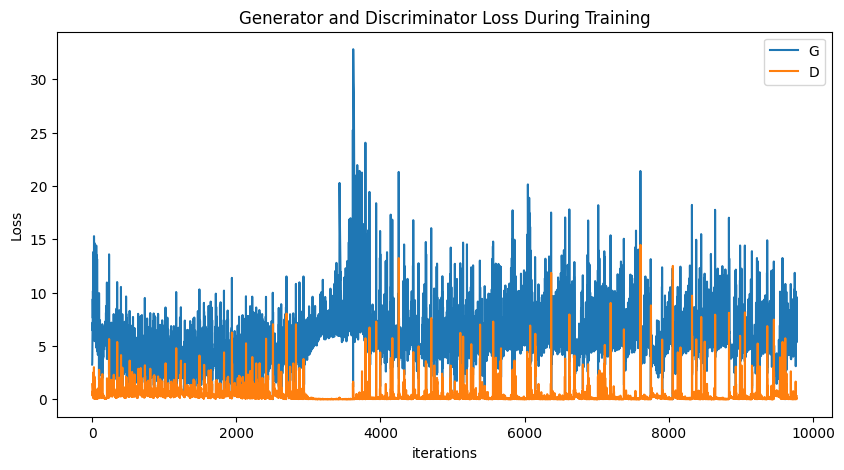

In [8]:

# Plot and save results
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
 

In [9]:
import imageio

# Convert images to uint8 for saving as GIF
images = [np.transpose(vutils.make_grid(img, padding=2, normalize=True), (1, 2, 0)).numpy() for img in img_list]
images_uint8 = [np.uint8(255 * image) for image in images]  # Scale to [0, 255] and convert to uint8
imageio.mimsave('dcgan_cifar10.gif', images_uint8, fps=5)


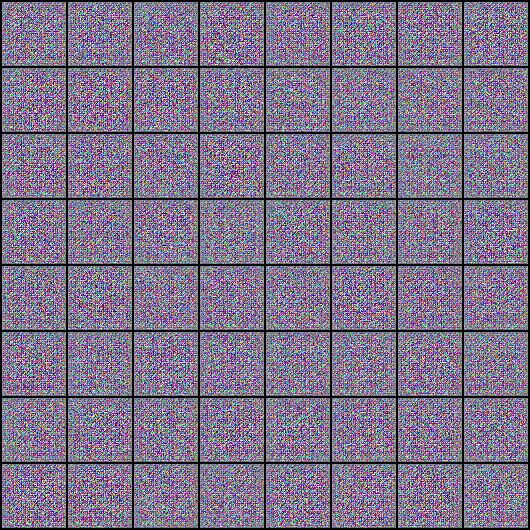

In [10]:
from IPython.display import Image

# Display the generated GIF
Image(filename="dcgan_cifar10.gif")
